# Experimentation of Face Detectors

## 1. Haar Cascade <br>
> It is an Object Detection Algorithm used to identify faces in an image or a real time video. <br><br>
>The algorithm uses edge or line detection features proposed by Viola and Jones in their research paper “Rapid Object Detection using a Boosted Cascade of Simple Features” published in 2001. <br><br>

### Import libraries

In [1]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as img
from PIL import Image
import cv2

### Frontal 

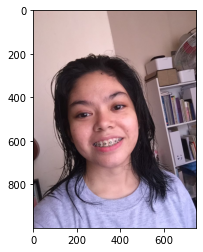

In [2]:
image = img.imread('C:\\Users\\Florence\\CompVision\\Face Detection\\Face_Images\\frontal1.jpg') #load image
plt.imshow(image)

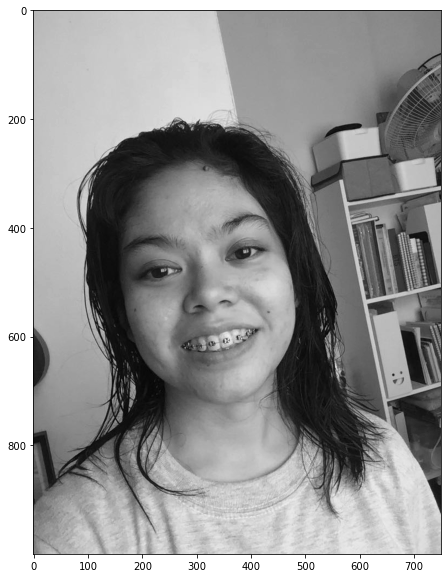

In [3]:
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY) #convert to grayscale

plt.figure(figsize=(20,10))
plt.imshow(gray, cmap='gray')

### Load the face classifier

In [4]:
face_cascade = cv2.CascadeClassifier('haarcascade_frontalface_default.xml') 

In [5]:
faces = face_cascade.detectMultiScale(gray, 4,6)

In [6]:
print('HaarCascade found' + str(len(faces)) + ' faces in this image')

HaarCascade found1 faces in this image


In [7]:
img_with_detections = np.copy(image)

### Draw box on face

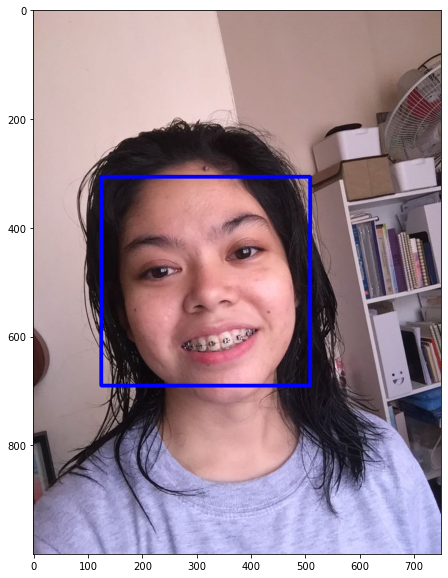

In [8]:
for (x,y,w,h) in faces:
    cv2.rectangle(img_with_detections,(x,y),(x+w,y+h),(0,0,255),5)
plt.figure(figsize=(20,10))
plt.imshow(img_with_detections)

### Load the model

In [9]:
import time
from tensorflow.keras.models import load_model
import pickle

In [10]:
#load trained model
model = load_model('C:\\Users\\Florence\\CompVision\\Face Detection\\facedetector-model.h5')

In [11]:
#load Labels
labels = ""
with open('C:\\Users\\Florence\\CompVision\\Face Detection\\labels.pkl', 'rb') as pf:
    labels = pickle.load(pf)
labels

{0: 'face'}

In [12]:
img_size = (150,150) #set image size

In [13]:
img_with_prediction = np.copy(image)

### Prediction and Accuracy

True

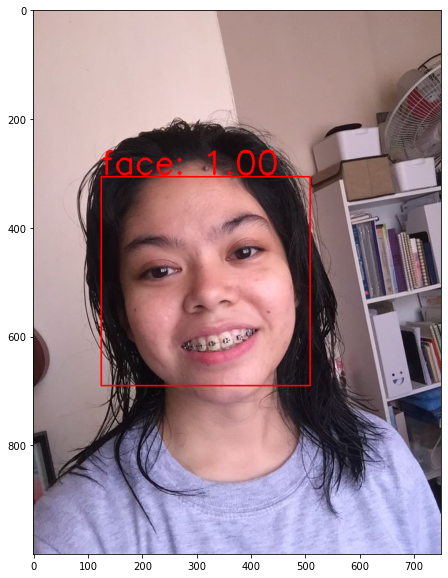

In [14]:
for (x,y,w,h) in faces:
    roi = img_with_prediction[y : y+h, x : x+w] #get region of interest
    data = cv2.resize(roi, img_size)/ 255. #resize image and flatten
    data = data.reshape((1,) + data.shape) #reshape the data to fit model
    scores = model.predict(data) #predict
    target = np.argmax(scores, axis=1)[0]
    
    cv2.rectangle(img=img_with_prediction, pt1=(x, y), pt2=(x+w, y+h), color=(255, 0, 0), thickness=2)
    text = "{}: {:.2f}".format(labels[target], scores[0][target])
    cv2.putText(img_with_prediction, text, (x, y-5), cv2.FONT_HERSHEY_SIMPLEX,2, (255,0,0), 4)

plt.figure(figsize=(20,10))
plt.imshow(img_with_prediction)
cv2.imwrite('f1.jpg', img_with_prediction)

### Frontal (close-up)

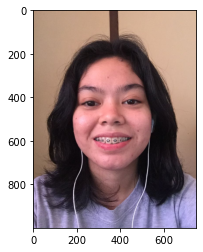

In [15]:
image = img.imread('C:\\Users\\Florence\\CompVision\\Face Detection\\Face_Images\\frontal2.jpg')
plt.imshow(image)

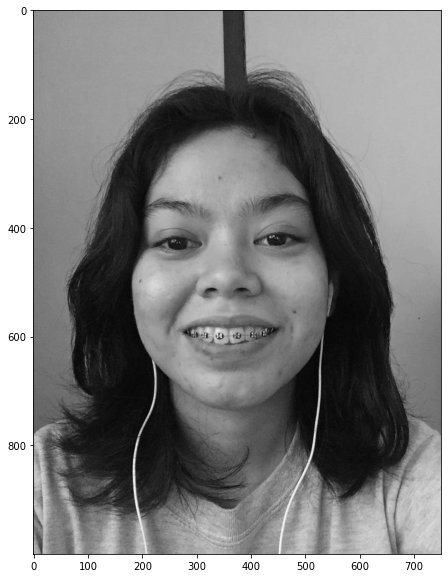

In [16]:
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

plt.figure(figsize=(20,10))
plt.imshow(gray, cmap='gray')

### Load the face classifier

In [17]:
faces = face_cascade.detectMultiScale(gray,4,5)

In [18]:
print('HaarCascade found' + str(len(faces)) + ' faces in this image')

HaarCascade found1 faces in this image


In [19]:
img_with_detections = np.copy(image)

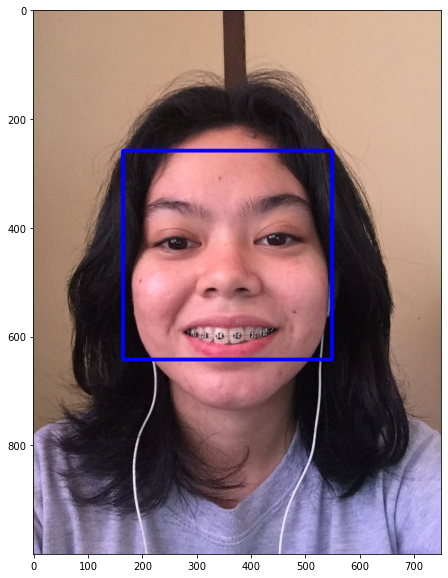

In [20]:
for (x,y,w,h) in faces:
    cv2.rectangle(img_with_detections,(x,y),(x+w,y+h),(0,0,255),5)
plt.figure(figsize=(20,10))
plt.imshow(img_with_detections)

In [21]:
img_with_prediction = np.copy(image)

### Prediction and Accuracy

True

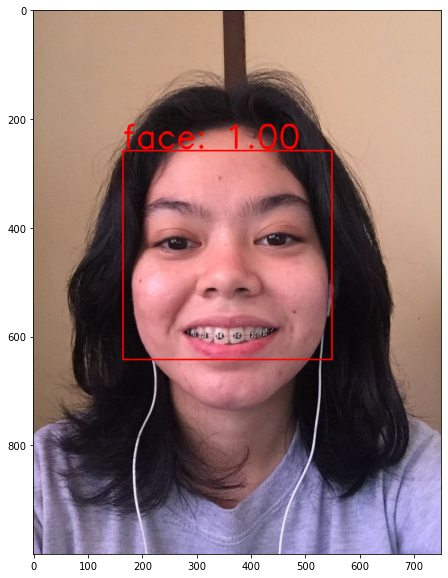

In [22]:
for (x,y,w,h) in faces:
    roi = img_with_prediction[y : y+h, x : x+w] #get region of interest
    data = cv2.resize(roi, img_size)/ 255. #resize image and flatten
    data = data.reshape((1,) + data.shape) #reshape the data to fit model
    scores = model.predict(data) #predict
    target = np.argmax(scores, axis=1)[0]
    
    cv2.rectangle(img=img_with_prediction, pt1=(x, y), pt2=(x+w, y+h), color=(255, 0, 0), thickness=2)
    text = "{}: {:.2f}".format(labels[target], scores[0][target])
    cv2.putText(img_with_prediction, text, (x, y-5), cv2.FONT_HERSHEY_SIMPLEX,2, (255,0,0), 4)

plt.figure(figsize=(20,10))
plt.imshow(img_with_prediction)
cv2.imwrite('f2.jpg', img_with_prediction)

### Occlusion (close-up)

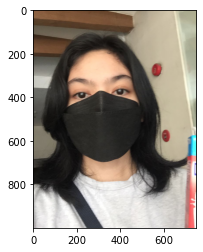

In [23]:
image = img.imread('C:\\Users\\Florence\\CompVision\\Face Detection\\Face_Images\occlusion1.jpg')
plt.imshow(image)

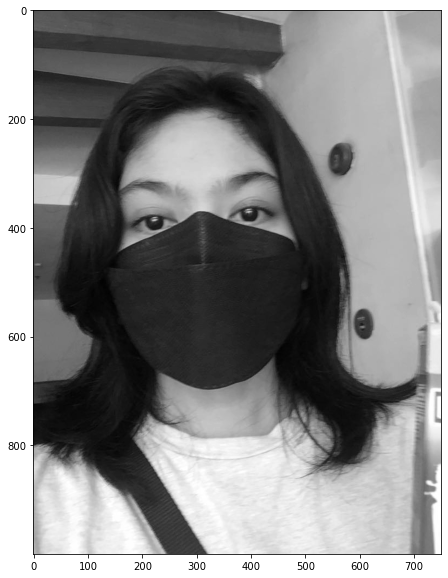

In [24]:
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

plt.figure(figsize=(20,10))
plt.imshow(gray, cmap='gray')

### Load the face classifier

In [41]:
faces = face_cascade.detectMultiScale(gray, 1.3,5)

In [42]:
print('HaarCascade found' + str(len(faces)) + ' faces in this image')

HaarCascade found0 faces in this image


In [43]:
img_with_detections = np.copy(image)

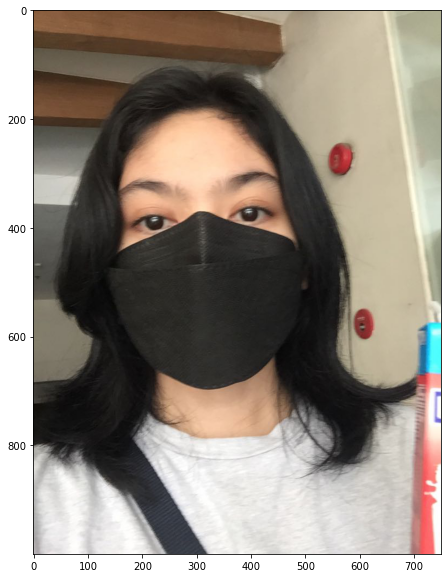

In [44]:
for (x,y,w,h) in faces:
    cv2.rectangle(img_with_detections,(x,y),(x+w,y+h),(0,0,255),5)
plt.figure(figsize=(20,10))
plt.imshow(img_with_detections)

In [45]:
img_with_prediction = np.copy(image)

In [46]:
### Prediction and Accuracy

True

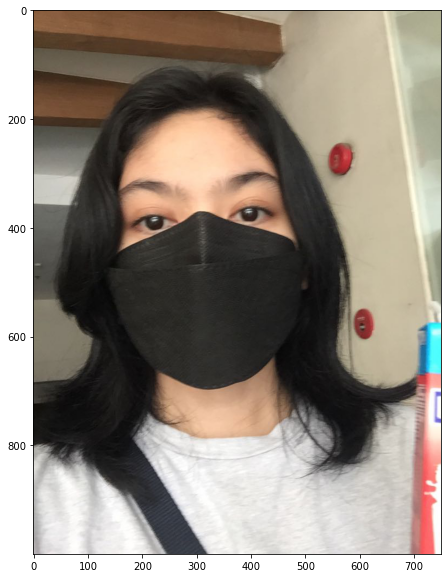

In [47]:
for (x,y,w,h) in faces:
    roi = img_with_prediction[y : y+h, x : x+w] #get region of interest
    data = cv2.resize(roi, img_size)/ 255. #resize image and flatten
    data = data.reshape((1,) + data.shape) #reshape the data to fit model
    scores = model.predict(data) #predict
    target = np.argmax(scores, axis=1)[0]
    
    cv2.rectangle(img=img_with_prediction, pt1=(x, y), pt2=(x+w, y+h), color=(255, 0, 0), thickness=2)
    text = "{}: {:.2f}".format(labels[target], scores[0][target])
    cv2.putText(img_with_prediction, text, (x, y-5), cv2.FONT_HERSHEY_SIMPLEX,2, (255,0,0), 4)

plt.figure(figsize=(20,10))
plt.imshow(img_with_prediction)
cv2.imwrite('o1.jpg', img_with_prediction)

### Occlusion (not close-up) 

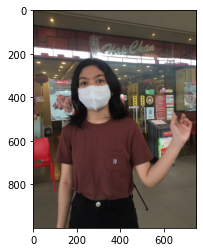

In [48]:
image = img.imread('C:\\Users\\Florence\\CompVision\\Face Detection\\Face_Images\occlusion2.jpg')
plt.imshow(image)

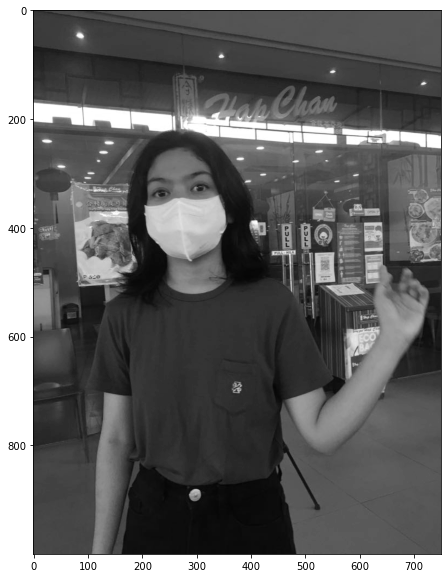

In [49]:
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

plt.figure(figsize=(20,10))
plt.imshow(gray, cmap='gray')

### Load the face classifier

In [66]:
faces = face_cascade.detectMultiScale(gray, 1.3,5)

In [67]:
print('HaarCascade found' + str(len(faces)) + ' faces in this image')

HaarCascade found1 faces in this image


In [68]:
img_with_detections = np.copy(image)

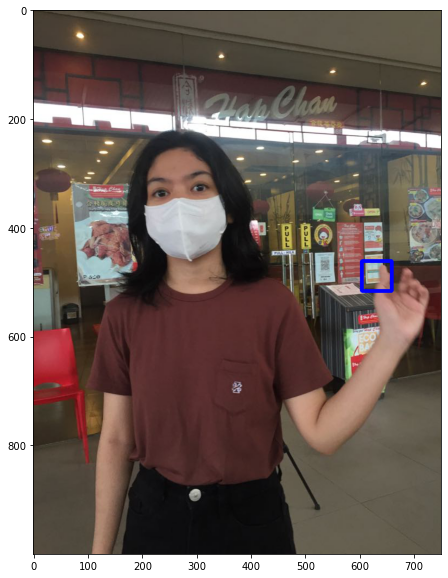

In [69]:
for (x,y,w,h) in faces:
    cv2.rectangle(img_with_detections,(x,y),(x+w,y+h),(0,0,255),5)
plt.figure(figsize=(20,10))
plt.imshow(img_with_detections)

In [70]:
img_with_prediction = np.copy(image)

### Prediction and Accuracy

True

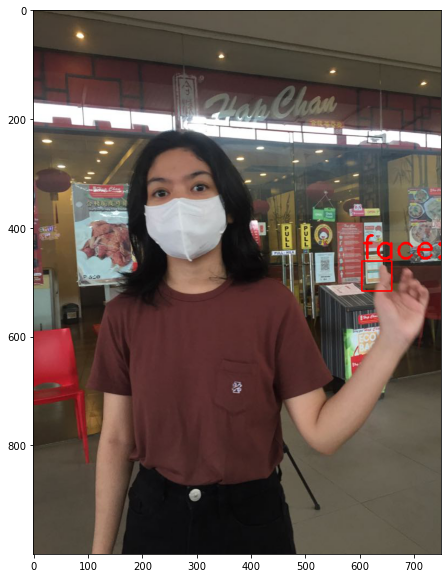

In [71]:
for (x,y,w,h) in faces:
    roi = img_with_prediction[y : y+h, x : x+w] #get region of interest
    data = cv2.resize(roi, img_size)/ 255. #resize image and flatten
    data = data.reshape((1,) + data.shape) #reshape the data to fit model
    scores = model.predict(data) #predict
    target = np.argmax(scores, axis=1)[0]
    
    cv2.rectangle(img=img_with_prediction, pt1=(x, y), pt2=(x+w, y+h), color=(255, 0, 0), thickness=2)
    text = "{}: {:.2f}".format(labels[target], scores[0][target])
    cv2.putText(img_with_prediction, text, (x, y-5), cv2.FONT_HERSHEY_SIMPLEX,2, (255,0,0), 4)

plt.figure(figsize=(20,10))
plt.imshow(img_with_prediction)
cv2.imwrite('o2.jpg', img_with_prediction)

### Face Upward 

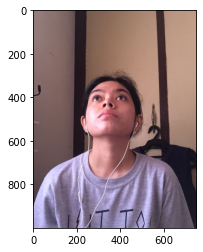

In [72]:
image = img.imread('C:\\Users\\Florence\\CompVision\\Face Detection\\Face_Images\\upward1.jpg')
plt.imshow(image)

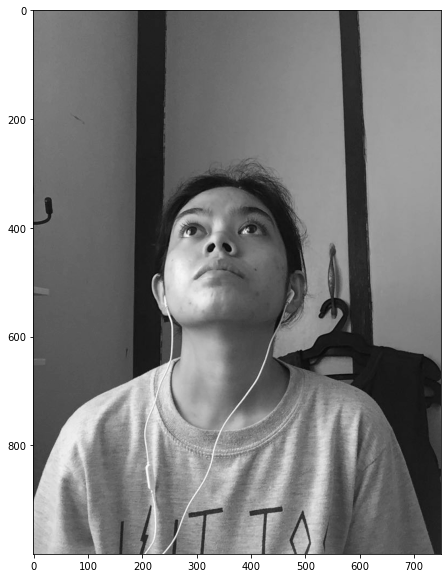

In [73]:
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

plt.figure(figsize=(20,10))
plt.imshow(gray, cmap='gray')

### Load the face classifier

In [78]:
faces = face_cascade.detectMultiScale(gray, 1.3,5)

In [79]:
print('HaarCascade found' + str(len(faces)) + ' faces in this image')

HaarCascade found1 faces in this image


In [80]:
img_with_detections = np.copy(image)

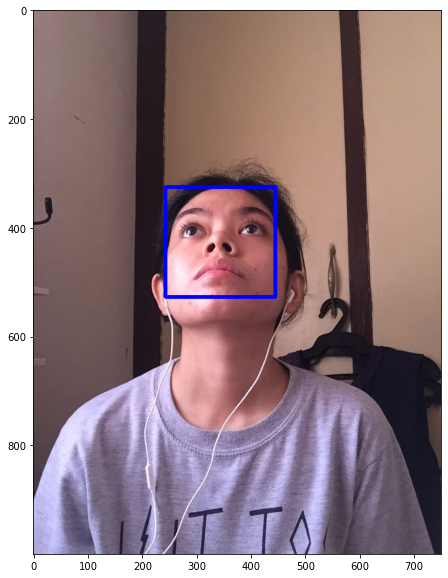

In [81]:
for (x,y,w,h) in faces:
    cv2.rectangle(img_with_detections,(x,y),(x+w,y+h),(0,0,255),5)
plt.figure(figsize=(20,10))
plt.imshow(img_with_detections)

In [82]:
img_with_prediction = np.copy(image)

### Prediction and Accuracy

True

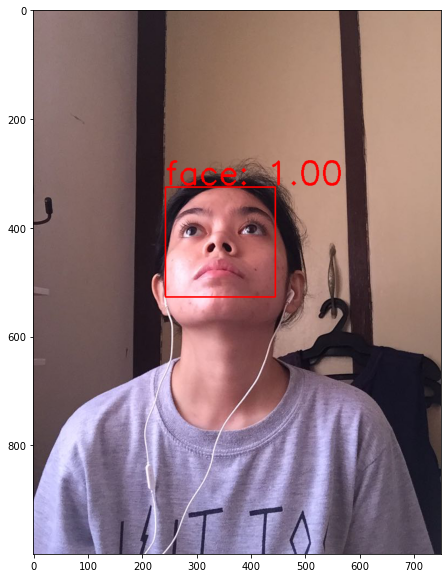

In [83]:
for (x,y,w,h) in faces:
    roi = img_with_prediction[y : y+h, x : x+w] #get region of interest
    data = cv2.resize(roi, img_size)/ 255. #resize image and flatten
    data = data.reshape((1,) + data.shape) #reshape the data to fit model
    scores = model.predict(data) #predict
    target = np.argmax(scores, axis=1)[0]
    
    cv2.rectangle(img=img_with_prediction, pt1=(x, y), pt2=(x+w, y+h), color=(255, 0, 0), thickness=2)
    text = "{}: {:.2f}".format(labels[target], scores[0][target])
    cv2.putText(img_with_prediction, text, (x, y-5), cv2.FONT_HERSHEY_SIMPLEX,2, (255,0,0), 4)

plt.figure(figsize=(20,10))
plt.imshow(img_with_prediction)
cv2.imwrite('u1.jpg', img_with_prediction)

### Face upward (side view)

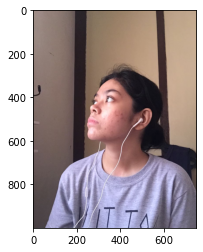

In [84]:
image = img.imread('C:\\Users\\Florence\\CompVision\\Face Detection\\Face_Images\\upward2.jpg')
plt.imshow(image)

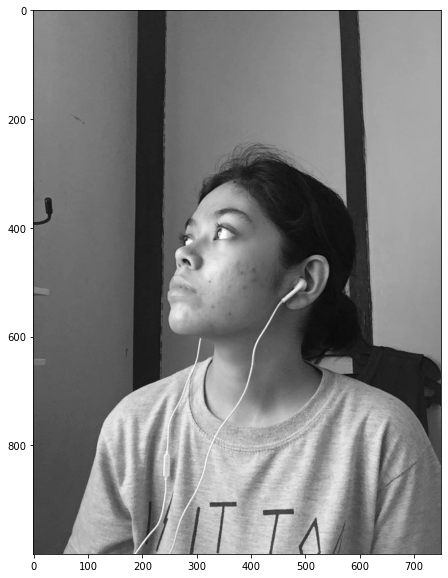

In [85]:
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

plt.figure(figsize=(20,10))
plt.imshow(gray, cmap='gray')

### Load the face classifier

In [90]:
faces = face_cascade.detectMultiScale(gray, 1.3,5)

In [91]:
print('HaarCascade found' + str(len(faces)) + ' faces in this image')

HaarCascade found0 faces in this image


In [92]:
img_with_detections = np.copy(image)

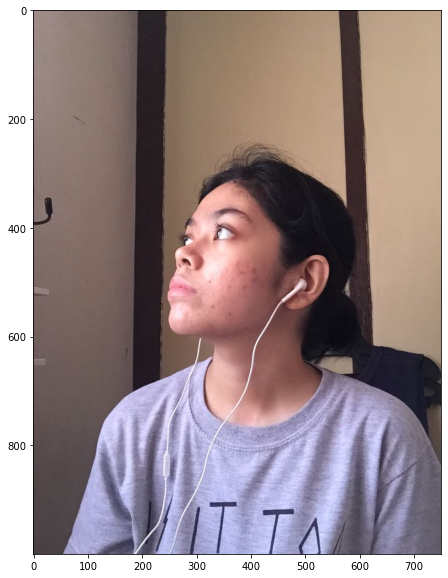

In [93]:
for (x,y,w,h) in faces:
    cv2.rectangle(img_with_detections,(x,y),(x+w,y+h),(0,0,255),5)
plt.figure(figsize=(20,10))
plt.imshow(img_with_detections)

In [94]:
img_with_prediction = np.copy(image)

### Prediction and Accuracy

True

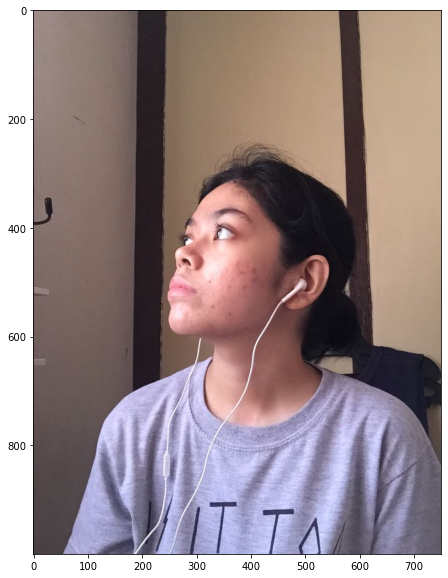

In [95]:
for (x,y,w,h) in faces:
    roi = img_with_prediction[y : y+h, x : x+w] #get region of interest
    data = cv2.resize(roi, img_size)/ 255. #resize image and flatten
    data = data.reshape((1,) + data.shape) #reshape the data to fit model
    scores = model.predict(data) #predict
    target = np.argmax(scores, axis=1)[0]
    
    cv2.rectangle(img=img_with_prediction, pt1=(x, y), pt2=(x+w, y+h), color=(255, 0, 0), thickness=2)
    text = "{}: {:.2f}".format(labels[target], scores[0][target])
    cv2.putText(img_with_prediction, text, (x, y-5), cv2.FONT_HERSHEY_SIMPLEX,2, (255,0,0), 4)

plt.figure(figsize=(20,10))
plt.imshow(img_with_prediction)
cv2.imwrite('u2.jpg', img_with_prediction)

### Face Downward

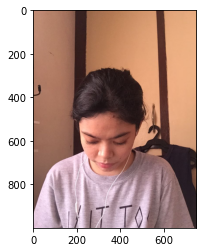

In [96]:
image = img.imread('C:\\Users\\Florence\\CompVision\\Face Detection\\Face_Images\\downward1.jpg')
plt.imshow(image)

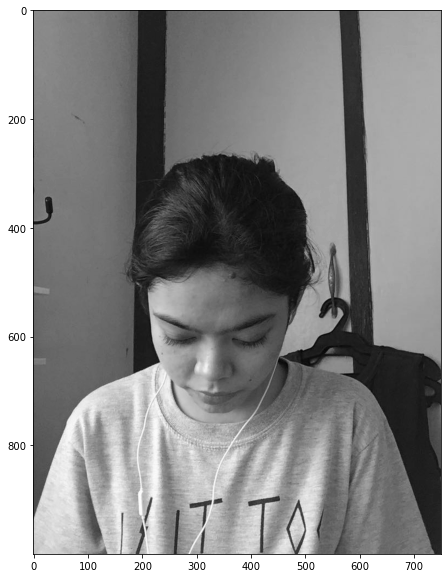

In [97]:
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

plt.figure(figsize=(20,10))
plt.imshow(gray, cmap='gray')

### Load the face classifier

In [106]:
faces = face_cascade.detectMultiScale(gray, 1.3,5)

In [107]:
print('HaarCascade found' + str(len(faces)) + ' faces in this image')

HaarCascade found0 faces in this image


In [108]:
img_with_detections = np.copy(image)

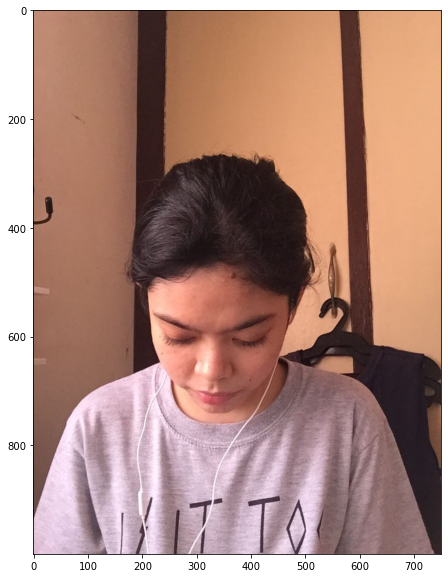

In [109]:
for (x,y,w,h) in faces:
    cv2.rectangle(img_with_detections,(x,y),(x+w,y+h),(0,0,255),5)
plt.figure(figsize=(20,10))
plt.imshow(img_with_detections)

In [110]:
img_with_prediction = np.copy(image)

### Prediction and Accuracy

True

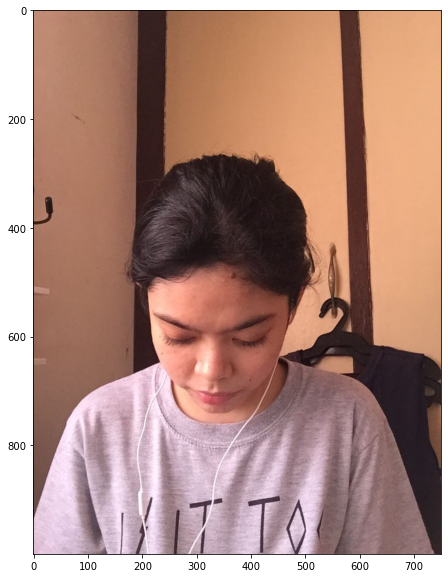

In [111]:
for (x,y,w,h) in faces:
    roi = img_with_prediction[y : y+h, x : x+w] #get region of interest
    data = cv2.resize(roi, img_size)/ 255. #resize image and flatten
    data = data.reshape((1,) + data.shape) #reshape the data to fit model
    scores = model.predict(data) #predict
    target = np.argmax(scores, axis=1)[0]
    
    cv2.rectangle(img=img_with_prediction, pt1=(x, y), pt2=(x+w, y+h), color=(255, 0, 0), thickness=2)
    text = "{}: {:.2f}".format(labels[target], scores[0][target])
    cv2.putText(img_with_prediction, text, (x, y-5), cv2.FONT_HERSHEY_SIMPLEX,2, (255,0,0), 4)

plt.figure(figsize=(20,10))
plt.imshow(img_with_prediction)
cv2.imwrite('d1.jpg', img_with_prediction)

### Face downward (side view)

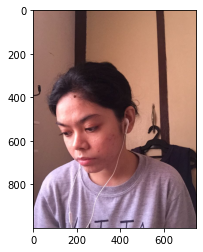

In [112]:
image = img.imread('C:\\Users\\Florence\\CompVision\\Face Detection\\Face_Images\\downward2.jpg')
plt.imshow(image)

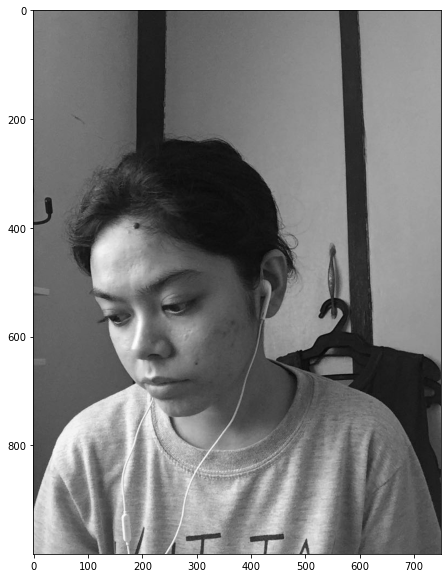

In [113]:
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

plt.figure(figsize=(20,10))
plt.imshow(gray, cmap='gray')

### Load the face classifier

In [120]:
faces = face_cascade.detectMultiScale(gray, 1.3,5)

In [121]:
print('HaarCascade found' + str(len(faces)) + ' faces in this image')

HaarCascade found1 faces in this image


In [122]:
img_with_detections = np.copy(image)

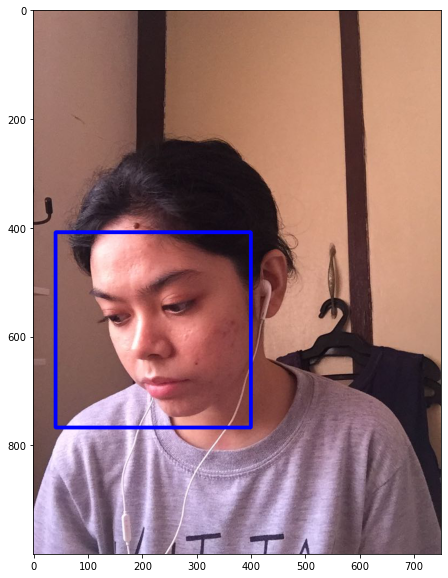

In [123]:
for (x,y,w,h) in faces:
    cv2.rectangle(img_with_detections,(x,y),(x+w,y+h),(0,0,255),5)
plt.figure(figsize=(20,10))
plt.imshow(img_with_detections)

In [124]:
img_with_prediction = np.copy(image)

### Prediction and Accuracy

True

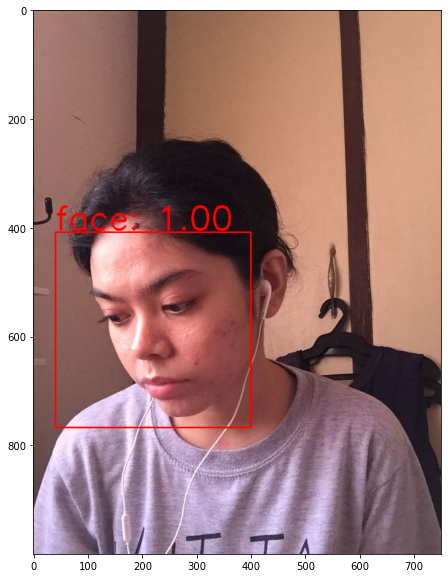

In [125]:
for (x,y,w,h) in faces:
    roi = img_with_prediction[y : y+h, x : x+w] #get region of interest
    data = cv2.resize(roi, img_size)/ 255. #resize image and flatten
    data = data.reshape((1,) + data.shape) #reshape the data to fit model
    scores = model.predict(data) #predict
    target = np.argmax(scores, axis=1)[0]
    
    cv2.rectangle(img=img_with_prediction, pt1=(x, y), pt2=(x+w, y+h), color=(255, 0, 0), thickness=2)
    text = "{}: {:.2f}".format(labels[target], scores[0][target])
    cv2.putText(img_with_prediction, text, (x, y-5), cv2.FONT_HERSHEY_SIMPLEX,2, (255,0,0), 4)

plt.figure(figsize=(20,10))
plt.imshow(img_with_prediction)
cv2.imwrite('d2.jpg', img_with_prediction)

### Compilation of output images using Haar Cascade

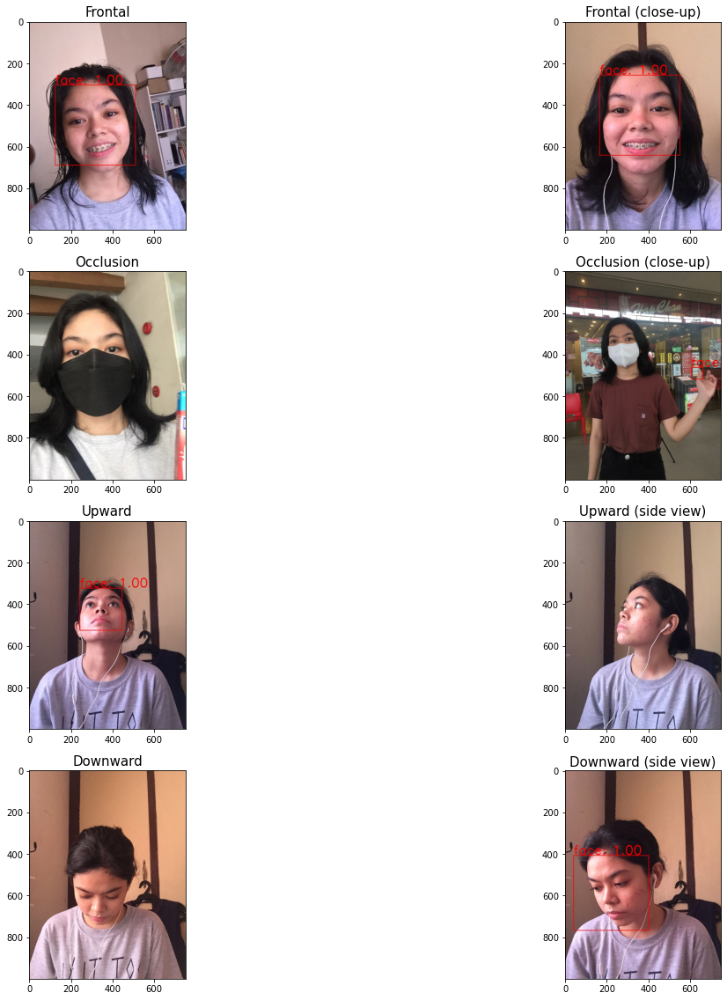

In [126]:
f1 = cv2.imread('f1.jpg')
f2 = cv2.imread('f2.jpg')
o1 = cv2.imread('o1.jpg')
o2 = cv2.imread('o2.jpg')
u1 = cv2.imread('u1.jpg')
u2 = cv2.imread('u2.jpg')
d1 = cv2.imread('d1.jpg')
d2 = cv2.imread('d2.jpg')

display = [f1, f2, o1, o2, u1, u2, d1, d2]
label = ['Frontal', 'Frontal (close-up)', 'Occlusion', 'Occlusion (close-up)', 'Upward', 'Upward (side view)', 'Downward', 'Downward (side view)']
  
fig = plt.figure(figsize=(20,20))
for i in range(len(display)):
    fig.add_subplot(4, 2, i+1)
    plt.imshow(display[i], cmap = 'gray')
    plt.title(label[i], fontsize=15)
plt.show()

### For Real-time Detection using Haar Cascade

In [73]:
import sys
import imutils

In [74]:
video_capture = cv2.VideoCapture(0)

while True:
    ret, frame = video_capture.read()
    frame = imutils.resize(frame, width=850)
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    
    faces = face_cascade.detectMultiScale(
        gray,
        scaleFactor=1.1,
        minNeighbors=5,
        minSize=(25,25)
    )
    for (x,y,w,h) in faces:
        roi = frame[y : y+h, x : x+w] 
        data = cv2.resize(roi, img_size)/ 255. 
        data = data.reshape((1,) + data.shape) 
        scores = model.predict(data) 
        target = np.argmax(scores, axis=1)[0]
    
        cv2.rectangle(img=frame, pt1=(x, y), pt2=(x+w, y+h), color=(255, 0, 0), thickness=2)
        text = "{}: {:.2f}".format(labels[target], scores[0][target])
        cv2.putText(frame, text, (x, y-5), cv2.FONT_HERSHEY_SIMPLEX,2, (255,0,0), 4)
    cv2.imshow('Haarcascade Realtime Detection', frame)
    
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break
        
video_capture.release()
cv2.destroyAllWindows()

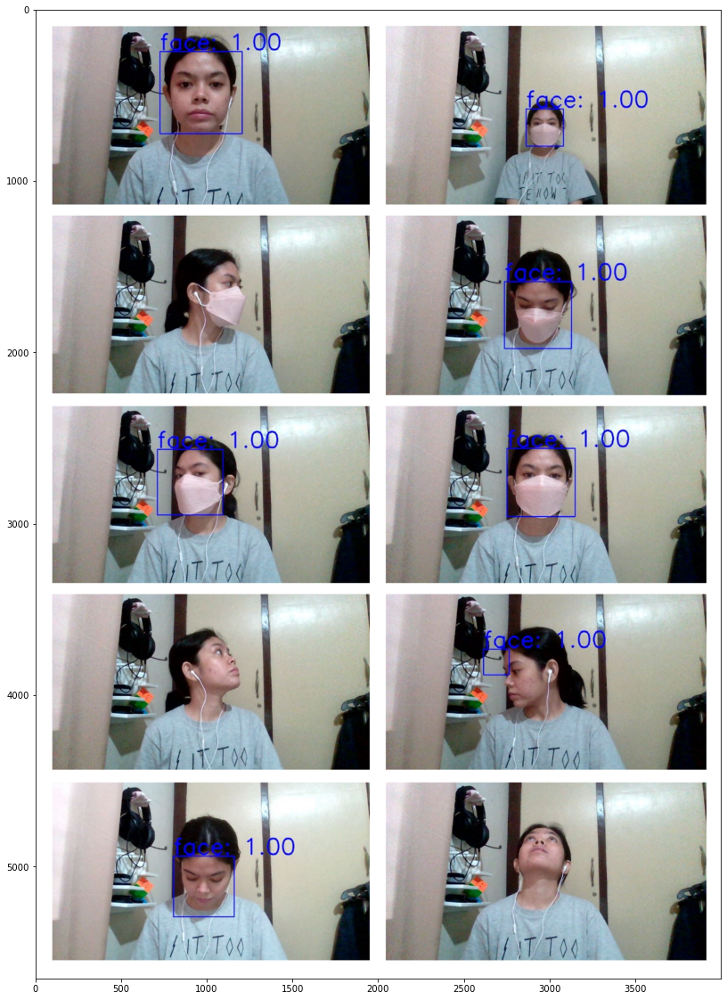

In [186]:
image = img.imread('C:\\Users\\Florence\\CompVision\\Face Detection\\Face_Images\\haar1.png')
plt.figure(figsize=(30,20))
plt.imshow(image)

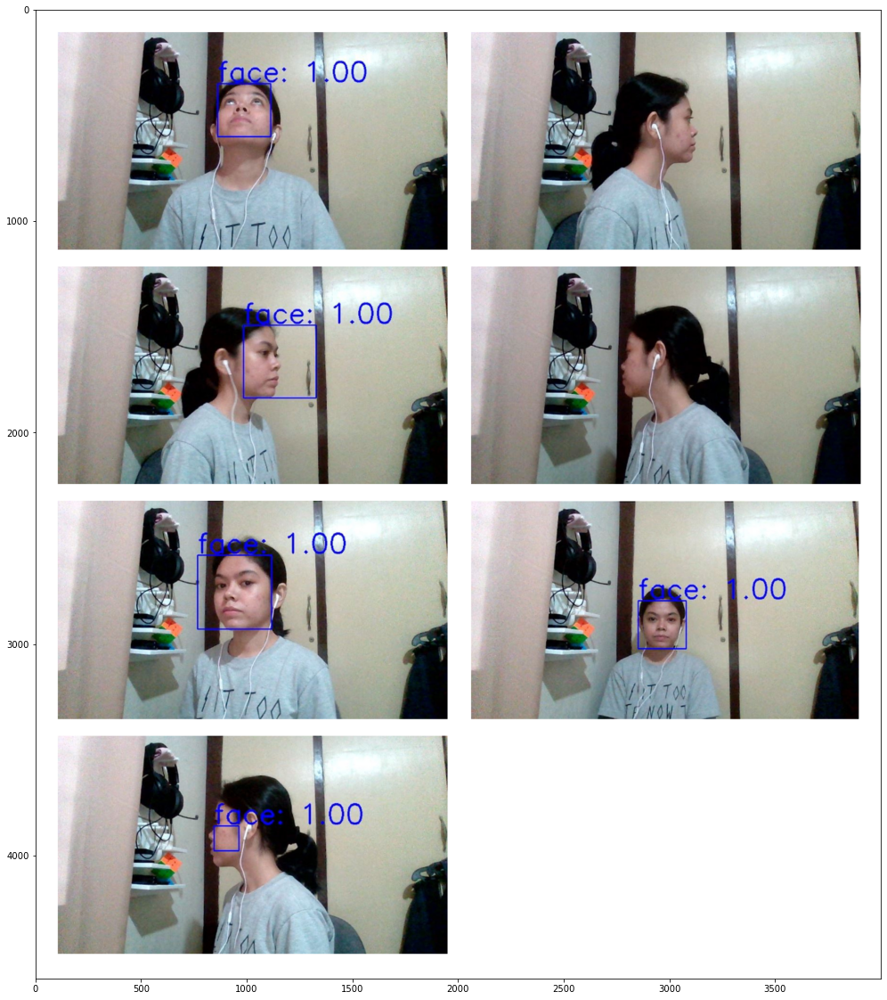

In [187]:
image = img.imread('C:\\Users\\Florence\\CompVision\\Face Detection\\Face_Images\\haar2.png')
plt.figure(figsize=(30,20))
plt.imshow(image)

### Haar Cascade and Inceptionv3 for Realtime Face Detection 

## 2. MTCNN <br>
>Multi-Task Cascaded Convolutional Neural Networks is a neural network which detects faces and facial landmarks on images. <br><br>
>It is a framework developed as a solution for both face detection and face alignment. The process consists of three stages of convolutional networks that are able to recognize faces and landmark location such as eyes, nose, and mouth.

### Import libraries

In [127]:
import mtcnn

In [128]:
face_detector = mtcnn.MTCNN()

### Frontal (close-up)

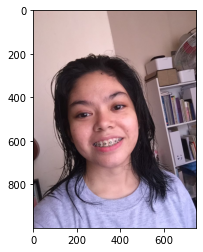

In [129]:
import matplotlib.image as img
img = img.imread("C:\\Users\\Florence\\CompVision\\Face Detection\\Face_Images\\frontal1.jpg")
plt.imshow(img)

### Get the keypoints

In [130]:
results = face_detector.detect_faces(img)
results

[{'box': [141, 295, 331, 426],
  'confidence': 0.999984860420227,
  'keypoints': {'left_eye': (232, 481),
   'right_eye': (385, 443),
   'nose': (328, 526),
   'mouth_left': (274, 624),
   'mouth_right': (419, 585)}}]

### Prediction and Accuracy

True

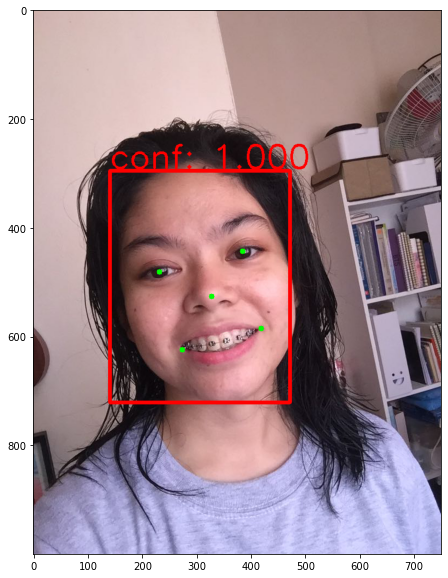

In [131]:
for res in results:
    x1,y1,w,h = res['box']
    x1,y1 = abs(x1), abs(y1)
    x2,y2 = x1+w, y1+h
    
    confidence = res['confidence']
    key_points = res['keypoints'].values()
    
    cv2.rectangle(img, (x1,y1), (x2,y2), (255, 0, 0), thickness=5)
    cv2.putText(img, f'conf: {confidence:.3f}', (x1,y1-5), cv2.FONT_HERSHEY_SIMPLEX, 2, (255, 0, 0), 4)
    
    for point in key_points:
        cv2.circle(img, point, 5, (0, 255, 0), thickness=-1)
        
plt.figure(figsize=(20,10))
plt.imshow(img)
cv2.imwrite('1f.jpg', img)

### Frontal (not close-up) 

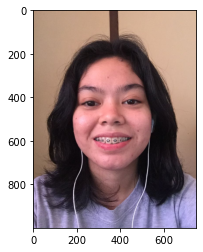

In [132]:
import matplotlib.image as img
img = img.imread("C:\\Users\\Florence\\CompVision\\Face Detection\\Face_Images\\frontal2.jpg")
plt.imshow(img)

### Get the keypoints

In [133]:
results = face_detector.detect_faces(img)
results

[{'box': [174, 197, 380, 537],
  'confidence': 0.9999866485595703,
  'keypoints': {'left_eye': (262, 418),
   'right_eye': (455, 420),
   'nose': (351, 504),
   'mouth_left': (266, 591),
   'mouth_right': (452, 589)}}]

### Prediction and Accuracy

True

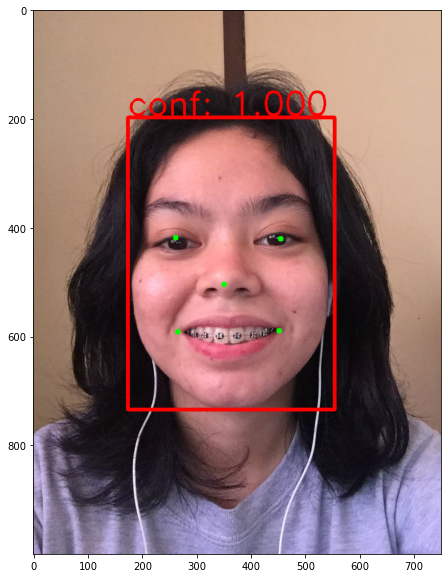

In [134]:
for res in results:
    x1,y1,w,h = res['box']
    x1,y1 = abs(x1), abs(y1)
    x2,y2 = x1+w, y1+h
    
    confidence = res['confidence']
    key_points = res['keypoints'].values()
    
    cv2.rectangle(img, (x1,y1), (x2,y2), (255, 0, 0), thickness=5)
    cv2.putText(img, f'conf: {confidence:.3f}', (x1,y1-5), cv2.FONT_HERSHEY_SIMPLEX, 2, (255, 0, 0), 4)
    
    for point in key_points:
        cv2.circle(img, point, 5, (0, 255, 0), thickness=-1)
        
plt.figure(figsize=(20,10))
plt.imshow(img)
cv2.imwrite('2f.jpg', img)

### Occlusion 

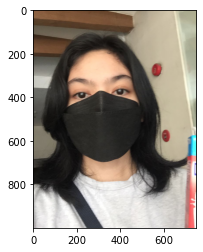

In [135]:
import matplotlib.image as img
img = img.imread("C:\\Users\\Florence\\CompVision\\Face Detection\\Face_Images\\occlusion1.jpg")
plt.imshow(img)

### Get the keypoints

In [136]:
results = face_detector.detect_faces(img)
results

[{'box': [148, 206, 327, 408],
  'confidence': 0.9993708729743958,
  'keypoints': {'left_eye': (239, 374),
   'right_eye': (403, 363),
   'nose': (336, 428),
   'mouth_left': (267, 532),
   'mouth_right': (403, 523)}}]

### Prediction and Accuracy

True

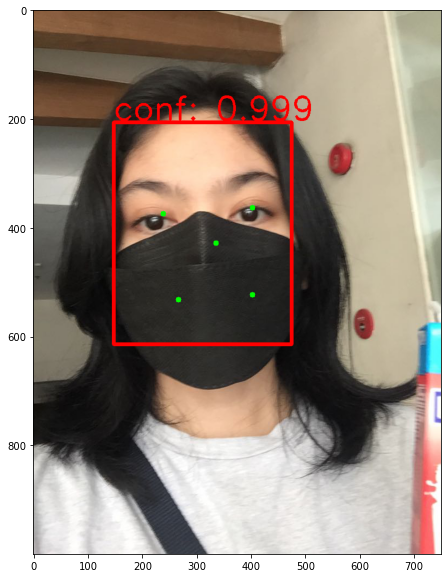

In [137]:
for res in results:
    x1,y1,w,h = res['box']
    x1,y1 = abs(x1), abs(y1)
    x2,y2 = x1+w, y1+h
    
    confidence = res['confidence']
    key_points = res['keypoints'].values()
    
    cv2.rectangle(img, (x1,y1), (x2,y2), (255, 0, 0), thickness=5)
    cv2.putText(img, f'conf: {confidence:.3f}', (x1,y1-5), cv2.FONT_HERSHEY_SIMPLEX, 2, (255, 0, 0), 4)
    
    for point in key_points:
        cv2.circle(img, point, 5, (0, 255, 0), thickness=-1)
        
plt.figure(figsize=(20,10))
plt.imshow(img)
cv2.imwrite('1o.jpg', img)

### Occlusion 

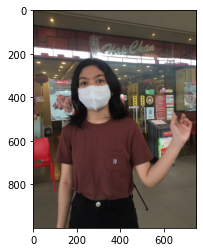

In [138]:
import matplotlib.image as img
img = img.imread("C:\\Users\\Florence\\CompVision\\Face Detection\\Face_Images\\occlusion2.jpg")
plt.imshow(img)

### Get the keypoints

In [139]:
results = face_detector.detect_faces(img)
results

[{'box': [201, 255, 153, 194],
  'confidence': 0.9999113082885742,
  'keypoints': {'left_eye': (235, 340),
   'right_eye': (306, 323),
   'nose': (275, 375),
   'mouth_left': (261, 411),
   'mouth_right': (314, 399)}}]

### Prediction and Accuracy

True

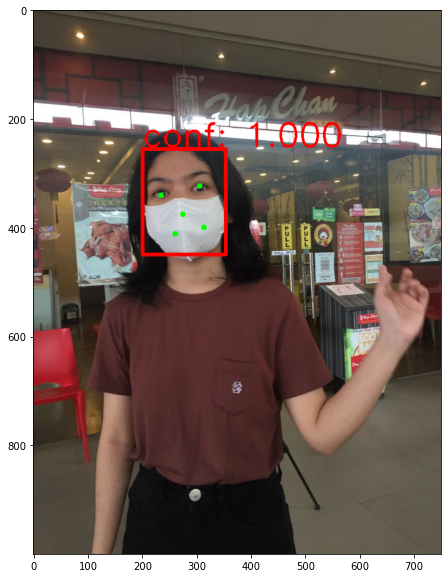

In [140]:
for res in results:
    x1,y1,w,h = res['box']
    x1,y1 = abs(x1), abs(y1)
    x2,y2 = x1+w, y1+h
    
    confidence = res['confidence']
    key_points = res['keypoints'].values()
    
    cv2.rectangle(img, (x1,y1), (x2,y2), (255, 0, 0), thickness=5)
    cv2.putText(img, f'conf: {confidence:.3f}', (x1,y1-5), cv2.FONT_HERSHEY_SIMPLEX, 2, (255, 0, 0), 4)
    
    for point in key_points:
        cv2.circle(img, point, 5, (0, 255, 0), thickness=-1)
        
plt.figure(figsize=(20,10))
plt.imshow(img)
cv2.imwrite('2o.jpg', img)

### Face upward 

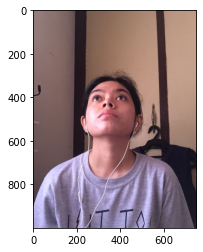

In [141]:
import matplotlib.image as img
img = img.imread("C:\\Users\\Florence\\CompVision\\Face Detection\\Face_Images\\upward1.jpg")
plt.imshow(img)

### Get the keypoints

In [142]:
results = face_detector.detect_faces(img)
results

[{'box': [253, 308, 219, 258],
  'confidence': 0.9999486207962036,
  'keypoints': {'left_eye': (302, 415),
   'right_eye': (404, 405),
   'nose': (343, 427),
   'mouth_left': (304, 498),
   'mouth_right': (387, 496)}}]

### Prediction and Accuracy

True

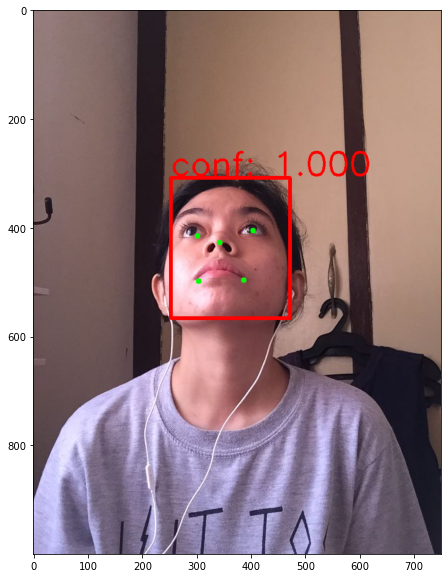

In [143]:
for res in results:
    x1,y1,w,h = res['box']
    x1,y1 = abs(x1), abs(y1)
    x2,y2 = x1+w, y1+h
    
    confidence = res['confidence']
    key_points = res['keypoints'].values()
    
    cv2.rectangle(img, (x1,y1), (x2,y2), (255, 0, 0), thickness=5)
    cv2.putText(img, f'conf: {confidence:.3f}', (x1,y1-5), cv2.FONT_HERSHEY_SIMPLEX, 2, (255, 0, 0), 4)
    
    for point in key_points:
        cv2.circle(img, point, 5, (0, 255, 0), thickness=-1)
        
plt.figure(figsize=(20,10))
plt.imshow(img)
cv2.imwrite('1u.jpg', img)

### Face upward 

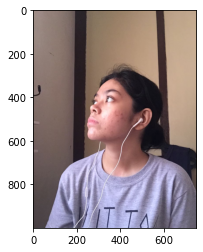

In [144]:
import matplotlib.image as img
img = img.imread("C:\\Users\\Florence\\CompVision\\Face Detection\\Face_Images\\upward2.jpg")
plt.imshow(img)

### Get the keypoints

In [145]:
results = face_detector.detect_faces(img)
results

[{'box': [247, 293, 224, 308],
  'confidence': 0.9999984502792358,
  'keypoints': {'left_eye': (293, 404),
   'right_eye': (349, 412),
   'nose': (256, 445),
   'mouth_left': (252, 517),
   'mouth_right': (295, 522)}}]

### Prediction and Accuracy

True

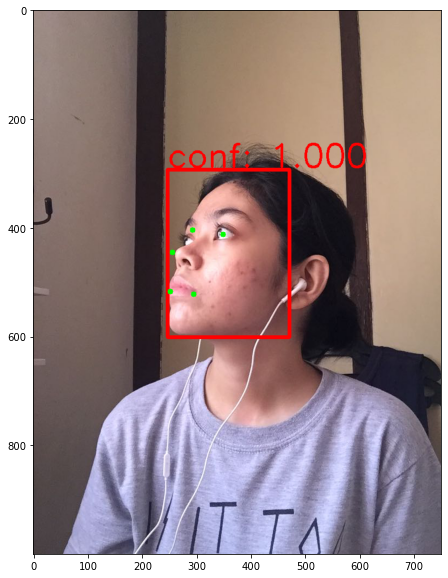

In [146]:
for res in results:
    x1,y1,w,h = res['box']
    x1,y1 = abs(x1), abs(y1)
    x2,y2 = x1+w, y1+h
    
    confidence = res['confidence']
    key_points = res['keypoints'].values()
    
    cv2.rectangle(img, (x1,y1), (x2,y2), (255, 0, 0), thickness=5)
    cv2.putText(img, f'conf: {confidence:.3f}', (x1,y1-5), cv2.FONT_HERSHEY_SIMPLEX, 2, (255, 0, 0), 4)
    
    for point in key_points:
        cv2.circle(img, point, 5, (0, 255, 0), thickness=-1)
        
plt.figure(figsize=(20,10))
plt.imshow(img)
cv2.imwrite('2u.jpg', img)

### Face downward 

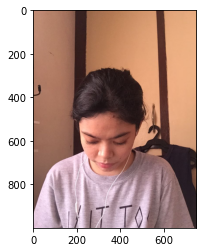

In [147]:
import matplotlib.image as img
img = img.imread("C:\\Users\\Florence\\CompVision\\Face Detection\\Face_Images\\downward1.jpg")
plt.imshow(img)

### Get the keypoints

In [148]:
results = face_detector.detect_faces(img)
results

[{'box': [206, 463, 249, 297],
  'confidence': 0.9999618530273438,
  'keypoints': {'left_eye': (274, 603),
   'right_eye': (394, 598),
   'nose': (331, 677),
   'mouth_left': (286, 696),
   'mouth_right': (398, 690)}}]

### Prediction and Accuracy

True

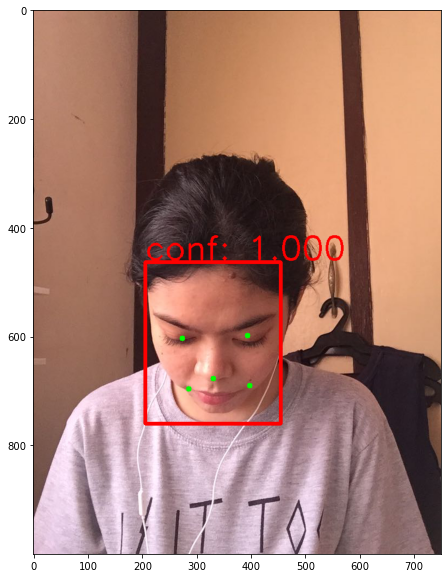

In [149]:
for res in results:
    x1,y1,w,h = res['box']
    x1,y1 = abs(x1), abs(y1)
    x2,y2 = x1+w, y1+h
    
    confidence = res['confidence']
    key_points = res['keypoints'].values()
    
    cv2.rectangle(img, (x1,y1), (x2,y2), (255, 0, 0), thickness=5)
    cv2.putText(img, f'conf: {confidence:.3f}', (x1,y1-5), cv2.FONT_HERSHEY_SIMPLEX, 2, (255, 0, 0), 4)
    
    for point in key_points:
        cv2.circle(img, point, 5, (0, 255, 0), thickness=-1)
        
plt.figure(figsize=(20,10))
plt.imshow(img)
cv2.imwrite('1d.jpg', img)

### Face downward 

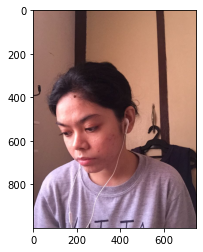

In [150]:
import matplotlib.image as img
img = img.imread("C:\\Users\\Florence\\CompVision\\Face Detection\\Face_Images\\downward2.jpg")
plt.imshow(img)

### Get the keypoints

In [151]:
results = face_detector.detect_faces(img)
results

[{'box': [131, 401, 277, 354],
  'confidence': 0.9999983310699463,
  'keypoints': {'left_eye': (160, 564),
   'right_eye': (266, 537),
   'nose': (195, 632),
   'mouth_left': (200, 697),
   'mouth_right': (295, 675)}}]

### Prediction and Accuracy

True

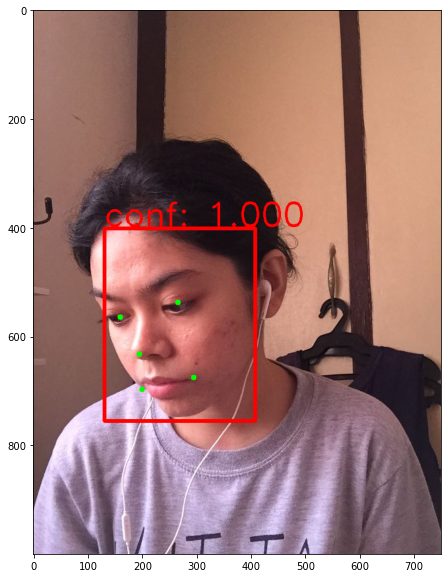

In [152]:
for res in results:
    x1,y1,w,h = res['box']
    x1,y1 = abs(x1), abs(y1)
    x2,y2 = x1+w, y1+h
    
    confidence = res['confidence']
    key_points = res['keypoints'].values()
    
    cv2.rectangle(img, (x1,y1), (x2,y2), (255, 0, 0), thickness=5)
    cv2.putText(img, f'conf: {confidence:.3f}', (x1,y1-5), cv2.FONT_HERSHEY_SIMPLEX, 2, (255, 0, 0), 4)
    
    for point in key_points:
        cv2.circle(img, point, 5, (0, 255, 0), thickness=-1)
        
plt.figure(figsize=(20,10))
plt.imshow(img)
cv2.imwrite('2d.jpg', img)

### Compilation of output images using MTCNN

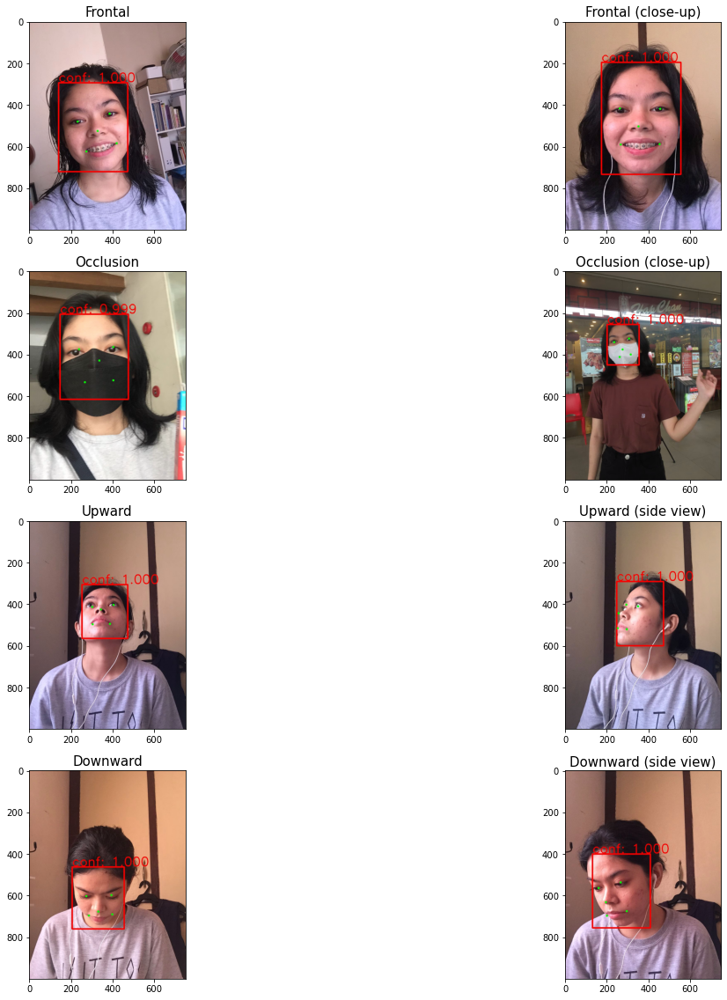

In [153]:
f = cv2.imread('1f.jpg')
ff = cv2.imread('2f.jpg')
o = cv2.imread('1o.jpg')
oo = cv2.imread('2o.jpg')
u = cv2.imread('1u.jpg')
uu = cv2.imread('2u.jpg')
d = cv2.imread('1d.jpg')
dd = cv2.imread('2d.jpg')

display = [f, ff, o, oo, u, uu, d, dd]
label = ['Frontal', 'Frontal (close-up)', 'Occlusion', 'Occlusion (close-up)', 'Upward', 'Upward (side view)', 'Downward', 'Downward (side view)']
  
fig = plt.figure(figsize=(20,20))
for i in range(len(display)):
    fig.add_subplot(4, 2, i+1)
    plt.imshow(display[i], cmap = 'gray')
    plt.title(label[i], fontsize=15)
plt.show()

### MTCNN for Real-time Face Detection 

In [154]:
face_detector = mtcnn.MTCNN()
vc = cv2.VideoCapture(0)
conf_t = 0.99

while vc.isOpened():
    ret, frame = vc.read()
    if not ret:
        print(':(')
        break
    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    results = face_detector.detect_faces(frame_rgb)
    for res in results:
        x1, y1, width, height = res['box']
        x1, y1 = abs(x1), abs(y1)
        x2, y2 = x1 + width, y1 + height

        confidence = res['confidence']
        if confidence < conf_t:
            continue
        key_points = res['keypoints'].values()

        cv2.rectangle(frame, (x1, y1), (x2, y2), (255, 0, 0), thickness=2)
        cv2.putText(frame, f'conf: {confidence:.3f}', (x1, y1), cv2.FONT_ITALIC, 1, (0, 0, 255), 1)

        for point in key_points:
            cv2.circle(frame, point, 5, (0, 255, 0), thickness=-1)

    cv2.imshow('smile', frame)
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break
        
vc.release()
cv2.destroyAllWindows()

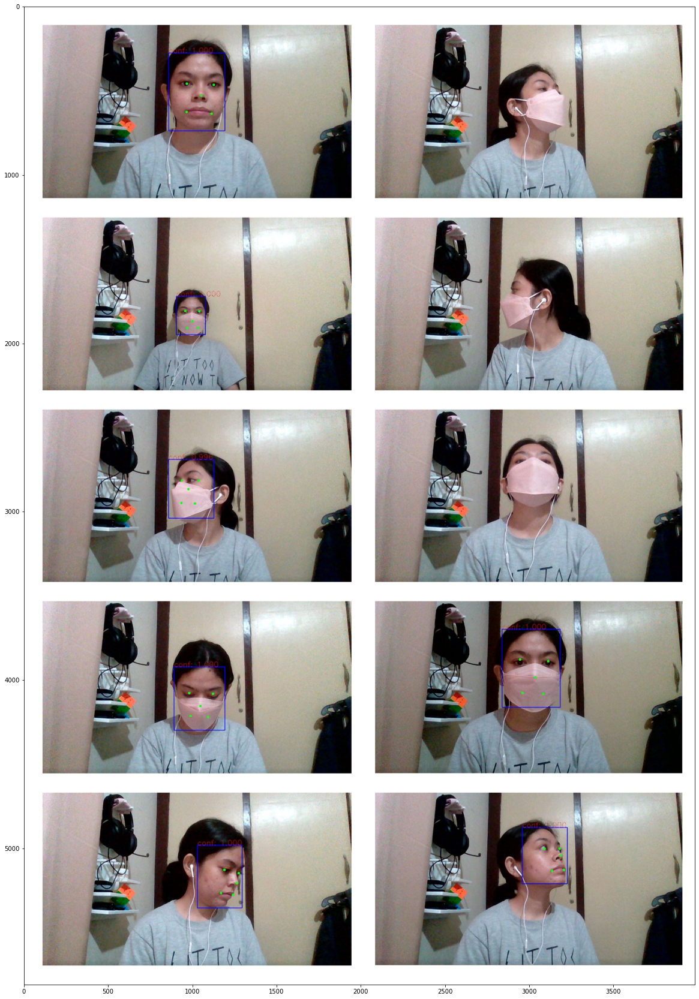

In [1]:
image = img.imread('C:\\Users\\Florence\\CompVision\\Face Detection\\Face_Images\\mtcnn1.png')
plt.figure(figsize=(40,30))
plt.imshow(image)

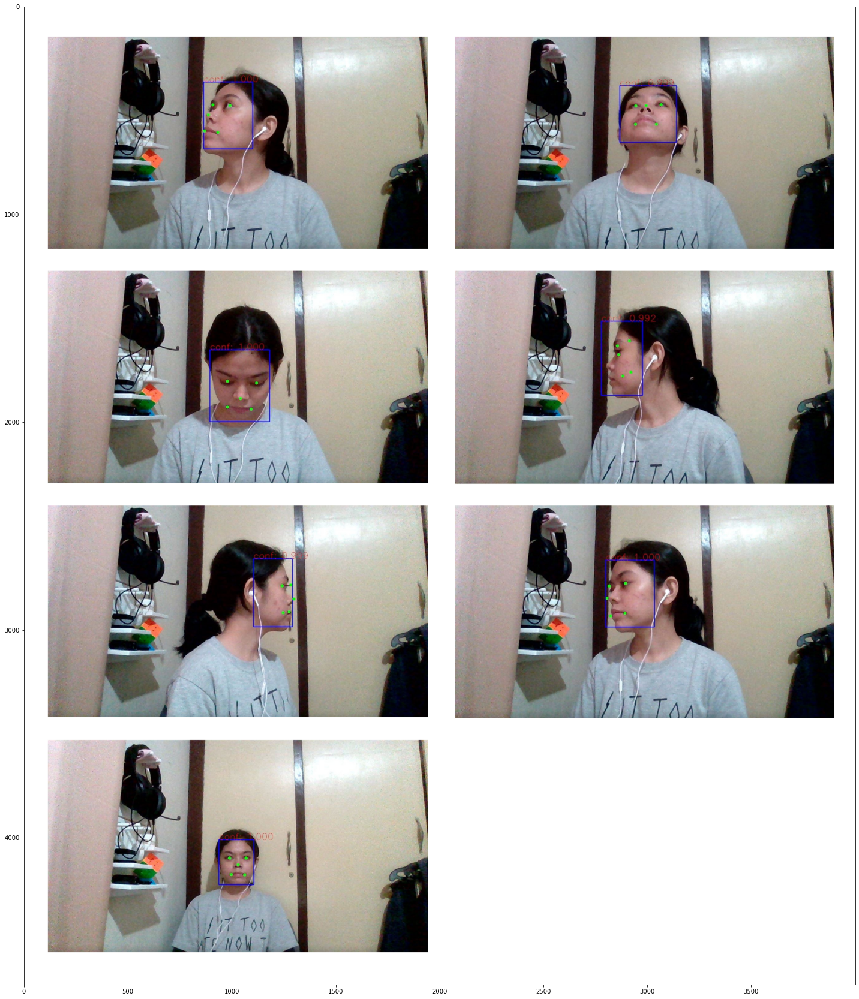

In [2]:
image = img.imread('C:\\Users\\Florence\\CompVision\\Face Detection\\Face_Images\\mtcnn2.png')
plt.figure(figsize=(40,30))
plt.imshow(image)

### Comparison of Haar Cascade and MTCNN

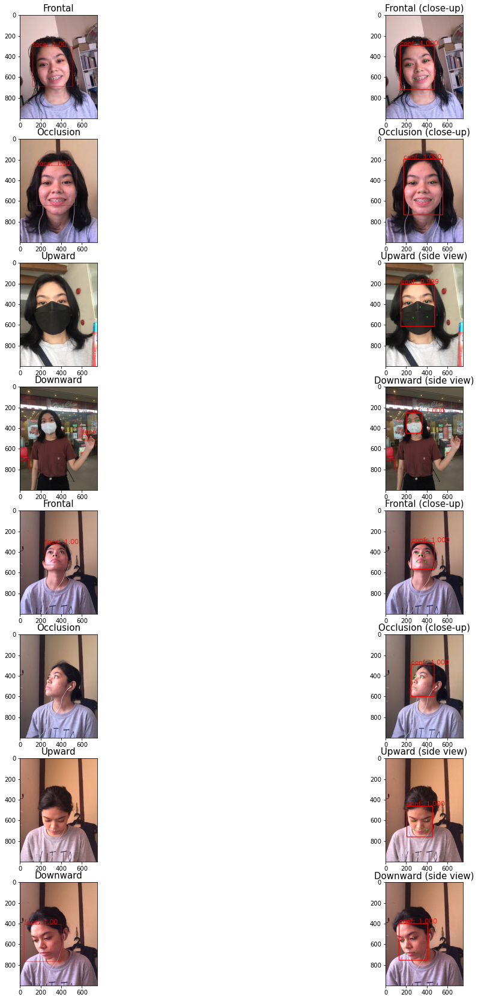

In [157]:
f1 = cv2.imread('f1.jpg')
f2 = cv2.imread('f2.jpg')
o1 = cv2.imread('o1.jpg')
o2 = cv2.imread('o2.jpg')
u1 = cv2.imread('u1.jpg')
u2 = cv2.imread('u2.jpg')
d1 = cv2.imread('d1.jpg')
d2 = cv2.imread('d2.jpg')
f = cv2.imread('1f.jpg')
ff = cv2.imread('2f.jpg')
o = cv2.imread('1o.jpg')
oo = cv2.imread('2o.jpg')
u = cv2.imread('1u.jpg')
uu = cv2.imread('2u.jpg')
d = cv2.imread('1d.jpg')
dd = cv2.imread('2d.jpg')


display = [f1,f,f2,ff,o1,o,o2,oo,u1,u,u2,uu,d1,d,d2,dd]
label = ['Frontal', 'Frontal (close-up)', 'Occlusion', 'Occlusion (close-up)', 'Upward', 
         'Upward (side view)', 'Downward', 'Downward (side view)', 'Frontal', 'Frontal (close-up)', 
         'Occlusion', 'Occlusion (close-up)', 'Upward', 'Upward (side view)', 'Downward', 'Downward (side view)']

  
fig = plt.figure(figsize=(20,60))
for i in range(len(display)):
    fig.add_subplot(16, 2, i+1)
    plt.imshow(display[i], cmap = 'gray')
    plt.title(label[i], fontsize=15)
plt.show()